# Assignment 2
## Bar code detector

Use a combination of image thresholding, edge detection and morphological operations to detect a bar code in an image. The workflow for this project is as follows:

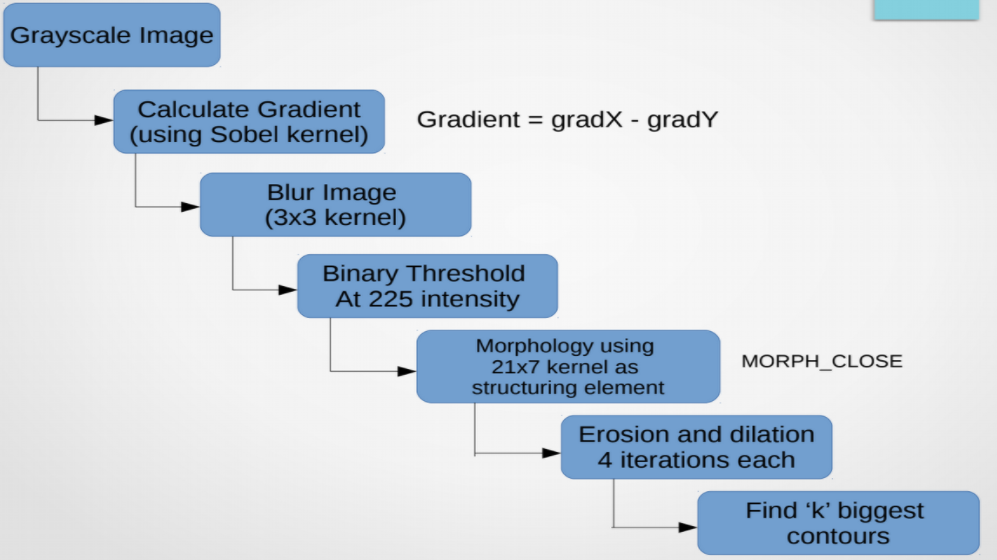

## Comments
Note that this method is one of many valid approaches to detecting bar codes in an image. There is even a Python Library, pyzbar which will automatically find and read barcodes. \
The purpose of this assignment is primarily to show how morphological processing can be used to identify features of interest in an image

Also, for the purposes of this assignment, assume only 1 bar code per image


## Submission Details
Assignment deadline: Midnight, Sunday 03 November \
Jupyter Notebook containing submission to be submitted via Canvas \
Total grade: 15% of final module mark \
Submit the assignment as a notebook (i.e. .iynb file) \
Use the following format for your filename: firstname_lastname_assignment2.ipynb

# Submission details:
#### Name: Patrick Noonan
#### ID: 20355426
#### Class code: MECE

In [2]:
# Load in required libraries
%matplotlib inline
import os
import os.path as op
import numpy as np
import cv2
import matplotlib.pylab as plt
from skimage import data, img_as_float, filters, feature
from skimage.morphology import binary_opening, binary_closing, binary_erosion, binary_dilation, disk

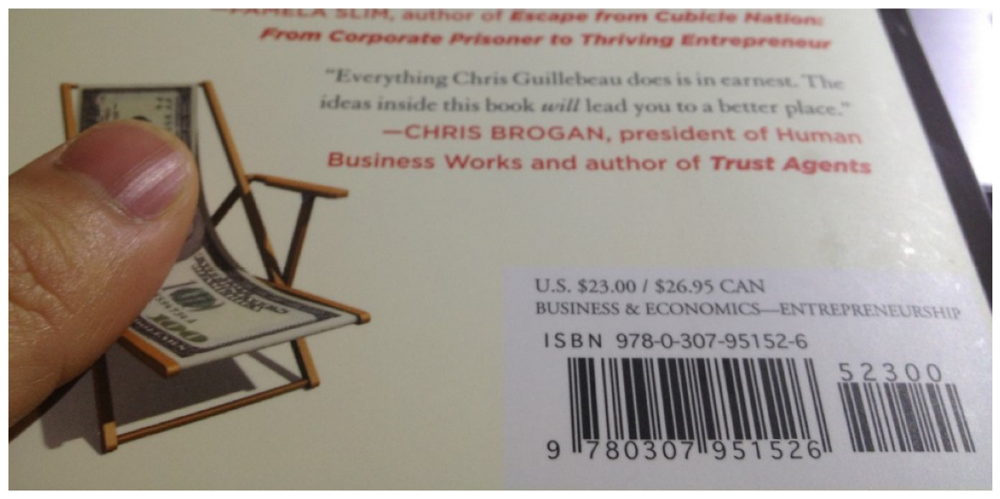

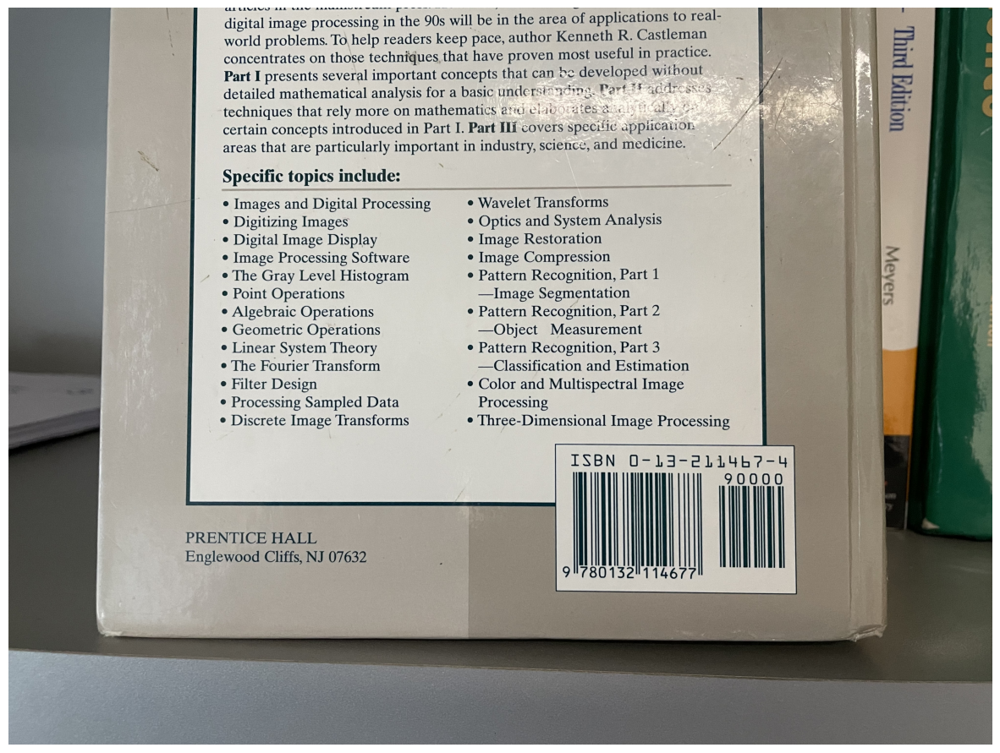

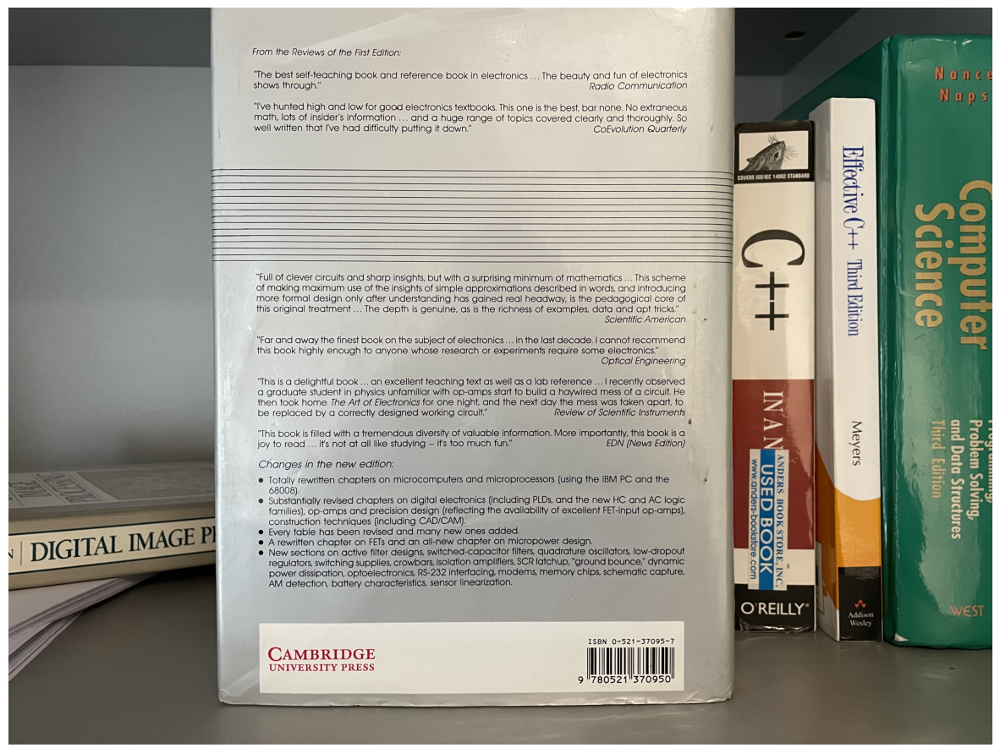

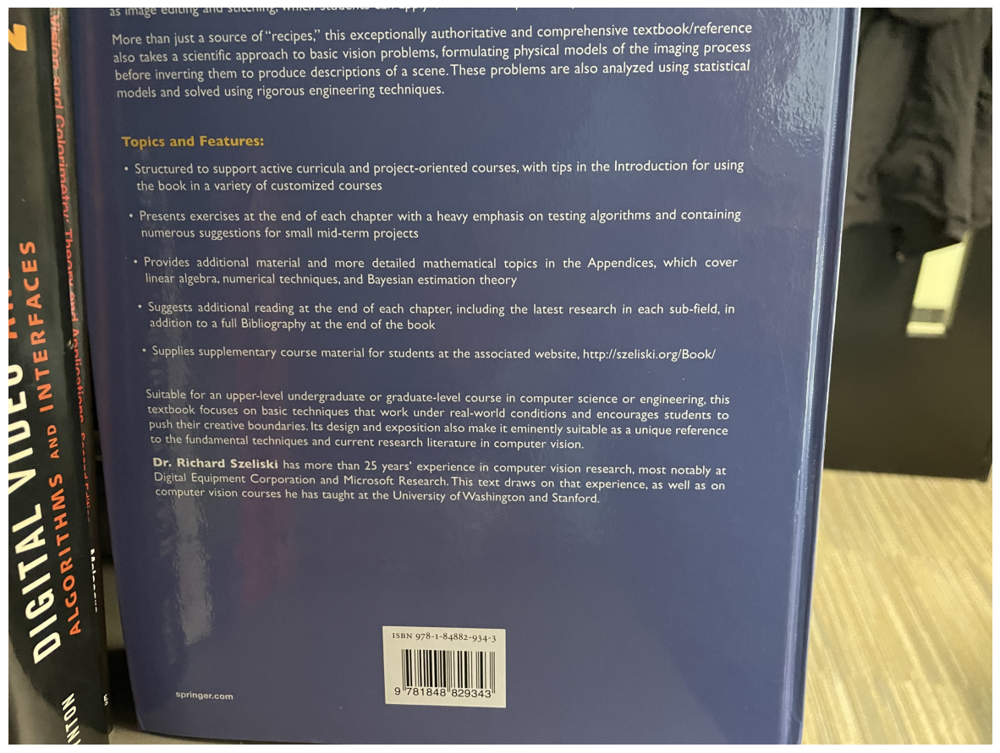

In [3]:
img_array = []
for i in range(1,5):
    img = cv2.imread('pics/bar_code'+str(i)+'.jpg')
    img = cv2.cvtColor(img,cv2.COLOR_BGR2RGB) # convert bgr to rgb
    img_array.append(img)

    # display image
    plt.figure(figsize=(15,15))
    plt.imshow(img)
    plt.axis('off')
    plt.show()



## Convert image to greyscale
Use open cv cvtColor function to do this

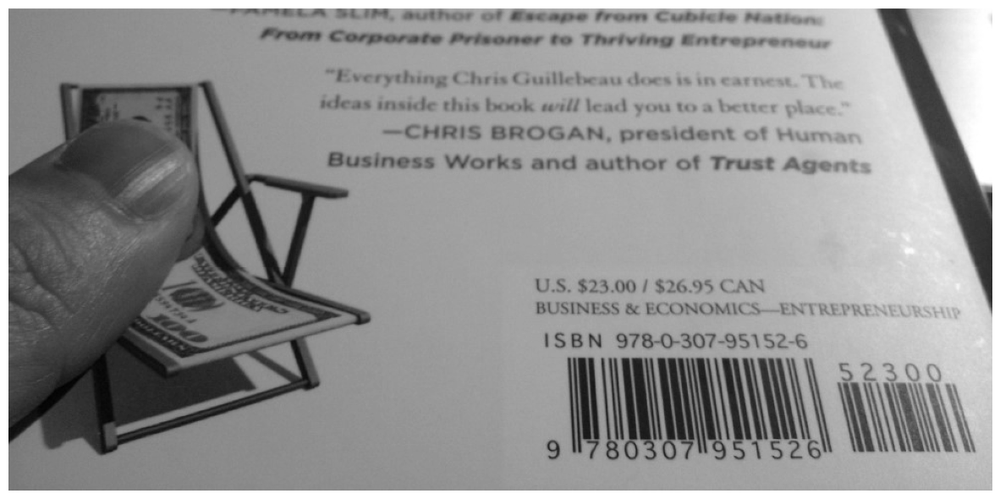

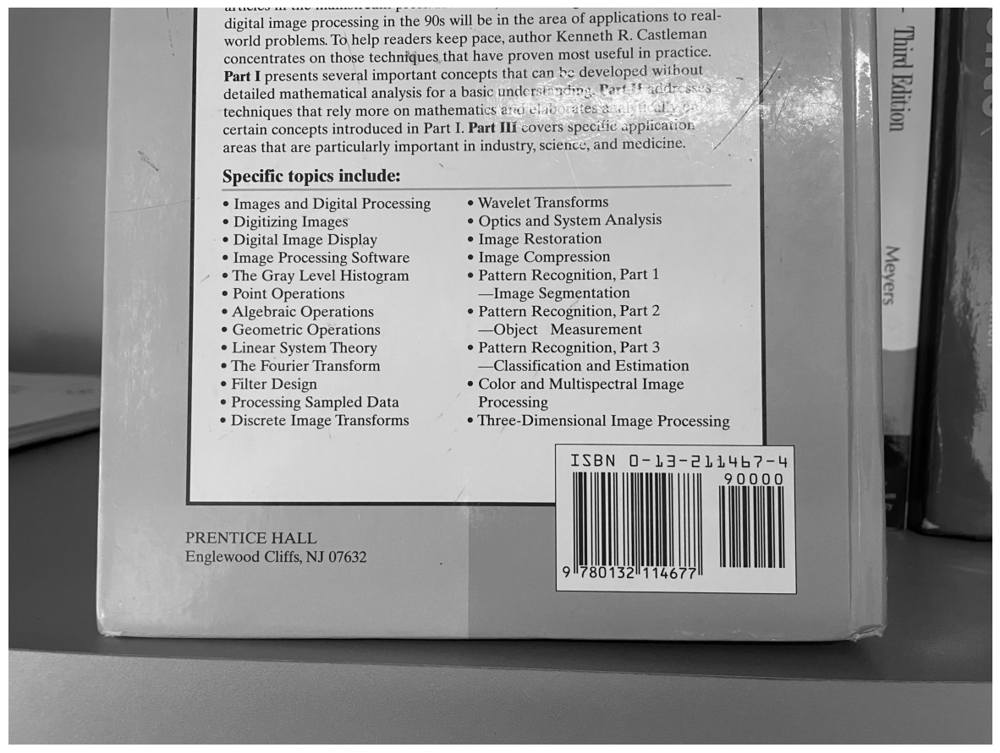

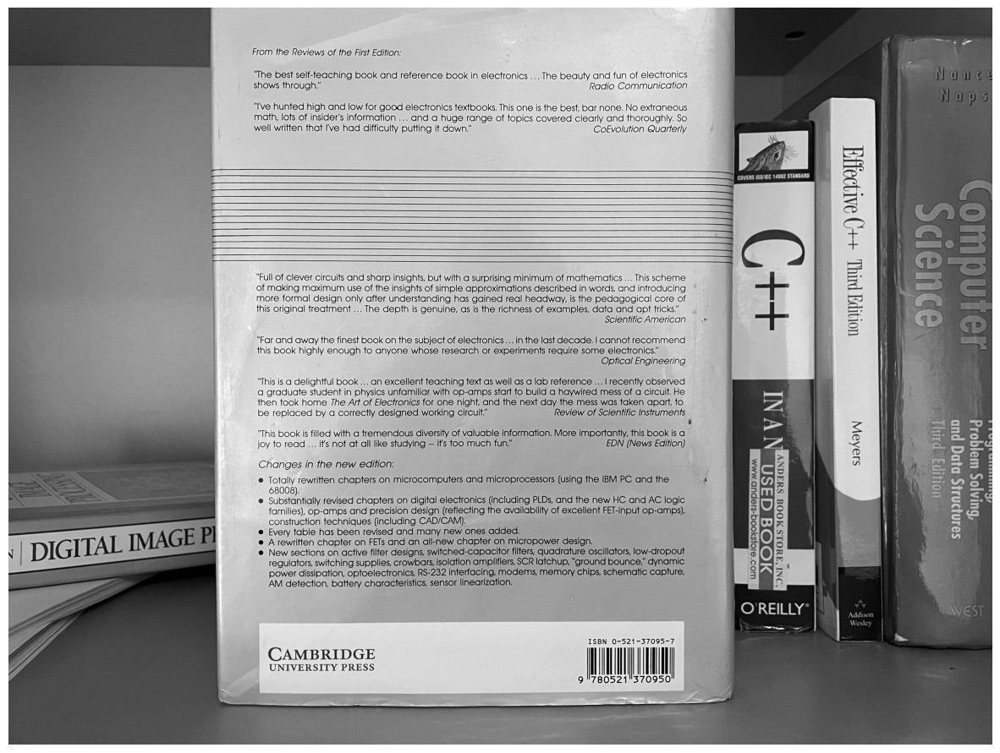

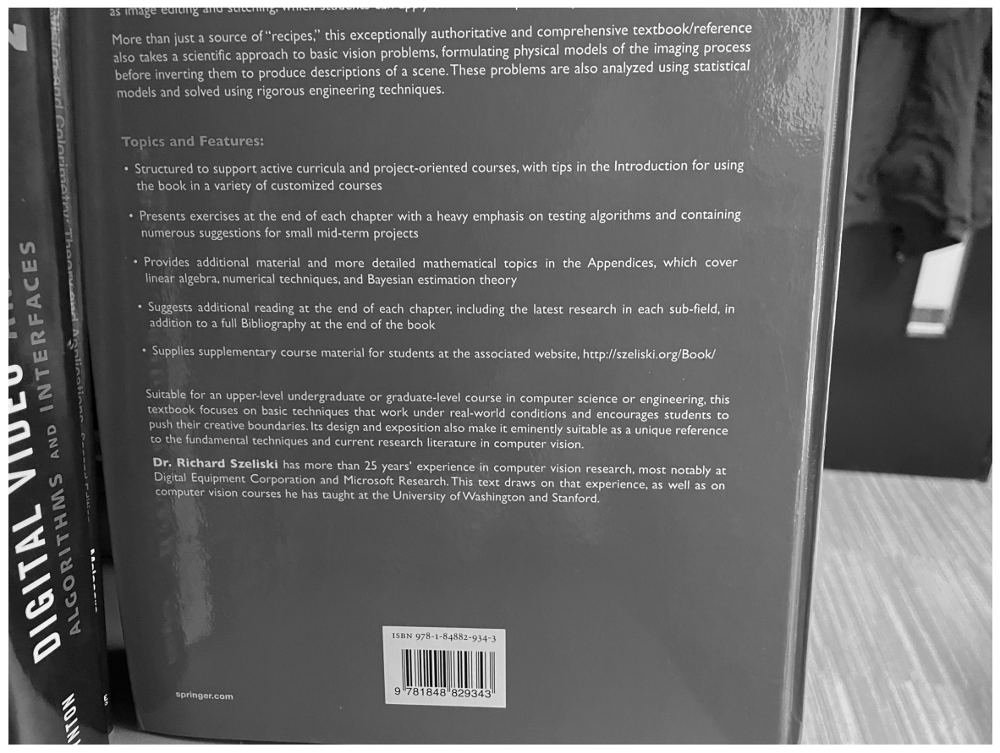

In [5]:
gray_array = []
for grayImg in img_array:
    gray = cv2.cvtColor(grayImg, cv2.COLOR_BGR2GRAY)
    gray_array.append(gray)

    # display the greyscale image
    plt.figure(figsize=(15,15))
    plt.imshow(gray, cmap='gray')
    plt.axis('off')
    plt.show()


## Calculate the image gradients

In this step, you need to find the image gradients (i.e. the edges of the image).
There are a number of ways to do this.

Example gradient functions are cv2.Sobel or cv2.Laplacian. If you use Sobel, it is recommended to try calculating both horizontal and vertical gradients, and use cv2.subtract to subtract x and y gradients. This is done by setting dx and dy parameters. 

experiment with differenct ksize parameters (size of filtering kernel)
For ddepth, set this to ddepth = cv2.CV_8UC1

for whichever gradient detector used, once you have calculated the gradients, scale and convert the image using cv2.convertScaleAbs function

When you plot the image, you should have something that looks like this:

![Gradient Image](<pics/gradient image.PNG>)

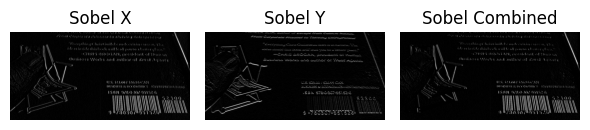

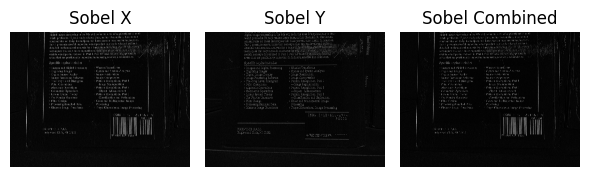

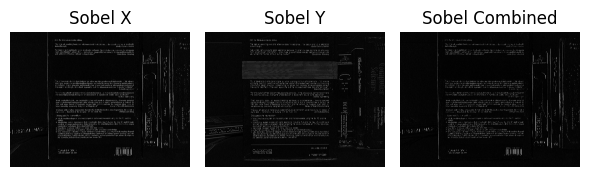

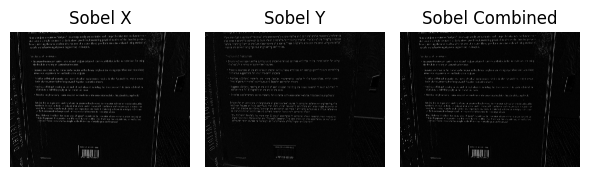

In [6]:
sobel_array = []

for grayImg in gray_array:
    edges_x = cv2.Sobel(grayImg, cv2.CV_8UC1, 1, 0, ksize=3)## Get the x gradient and y gradient
    edges_y = cv2.Sobel(grayImg, cv2.CV_8UC1, 0, 1, ksize=3)
    # subtract the y-gradient from the x-gradient
    edges = cv2.subtract(edges_x, edges_y)
    sobel_array.append(edges)

    fig, axes = plt.subplots(1, 3, figsize=(6, 12)) 
    
    # Plot Sobel X gradient
    axes[0].imshow(cv2.convertScaleAbs(edges_x), cmap='gray')
    axes[0].set_title('Sobel X')
    axes[0].axis('off')
    
    # Plot Sobel Y gradient
    axes[1].imshow(cv2.convertScaleAbs(edges_y), cmap='gray')
    axes[1].set_title('Sobel Y')
    axes[1].axis('off')
    
    # Plot Sobel Combined gradient
    axes[2].imshow(cv2.convertScaleAbs(edges), cmap='gray')
    axes[2].set_title('Sobel Combined')
    axes[2].axis('off')
    
    fig.tight_layout()
    plt.show()

## Comments on the Sobel Operation
- As you cans ee from the plots above the x derivative clearly brings out the vertical edges alot more with the y bringing out the horizontal edges.
- When these the x derivative is subtracted from the y derivative this clearly brings out the vertical lines of the bar code which is very good for our bar code detection algorithm.
- The blurb also has vertical edges but these are mixed with horizontal edges so it doesn't come out as defined as the barcode as the horizontal lines fade away a little bit with the subtraction operator.
- This helps to make the barcode the biggest contour towards the end of the operation. 

## Blur the image
This reduces noise and also removes some smaller gradients, and keeps only large gradients

Experiment with different blurring kernels, but the default cv2.blur with a kernel size of 3*3 is a good place to start...

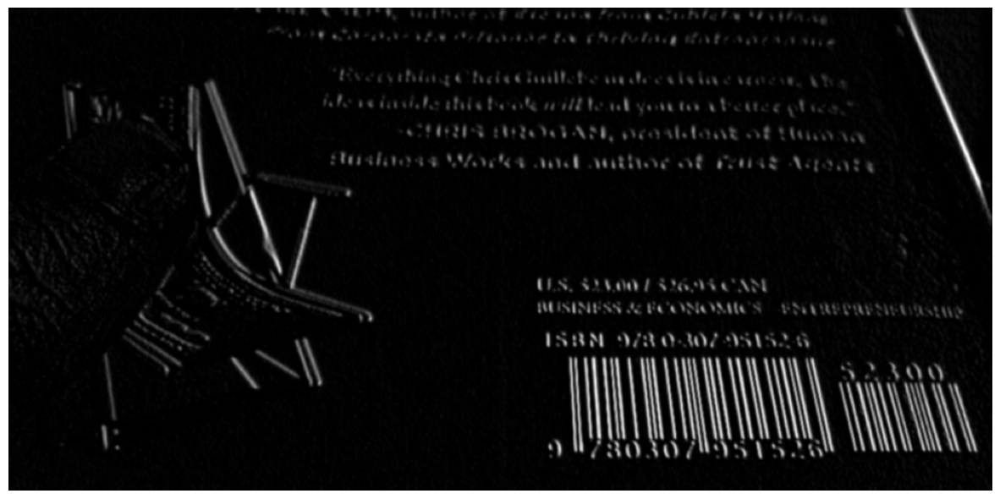

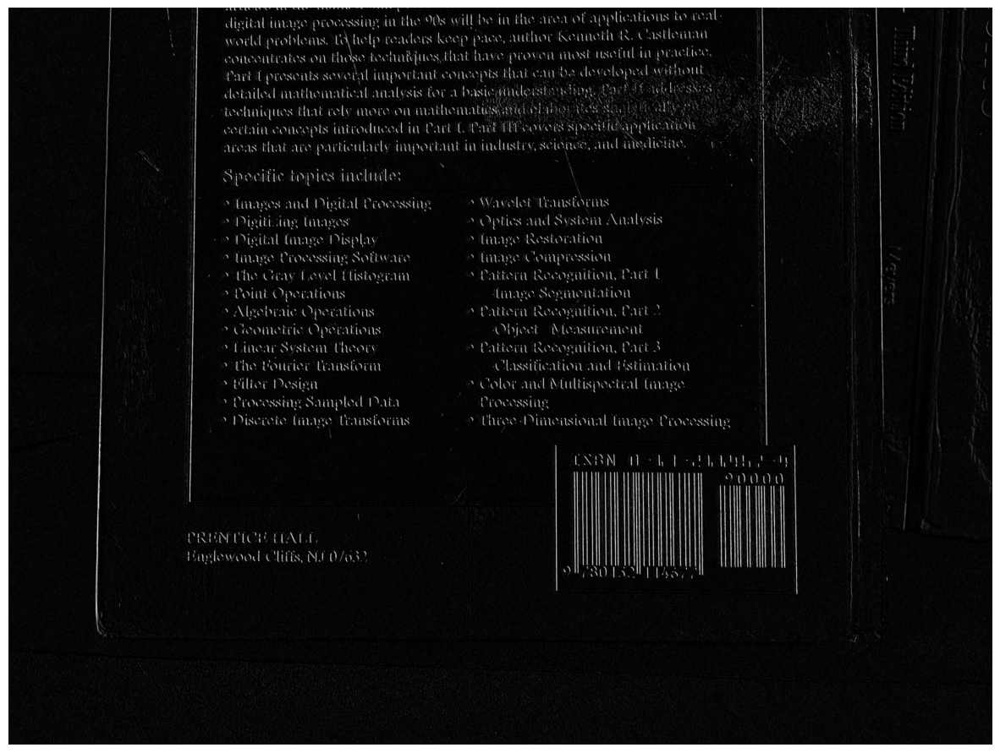

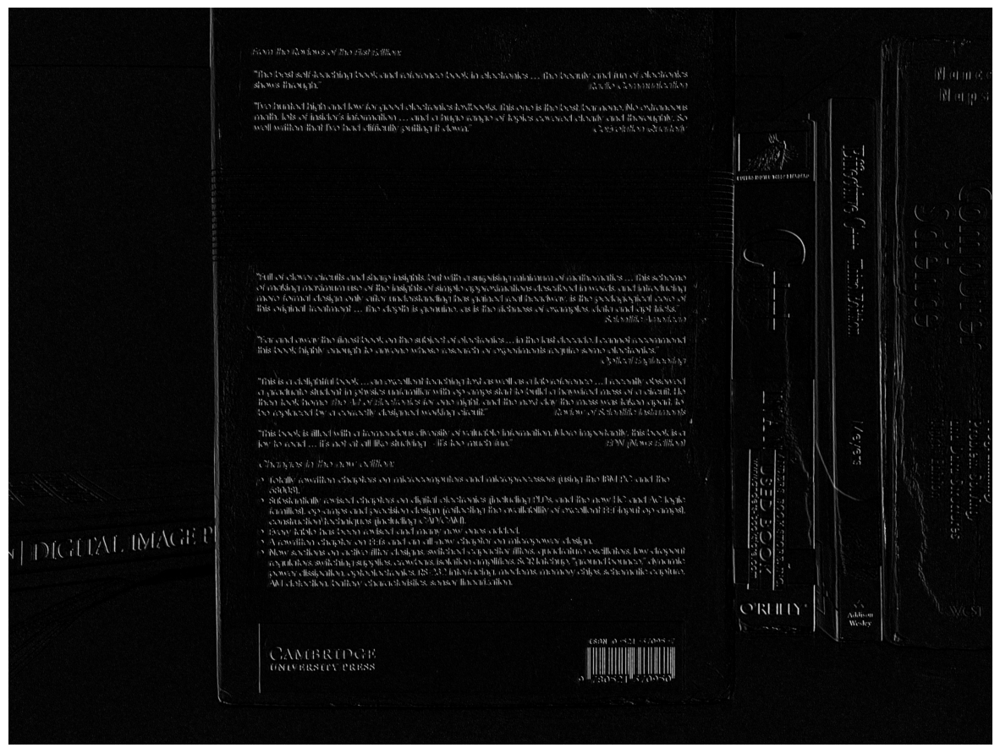

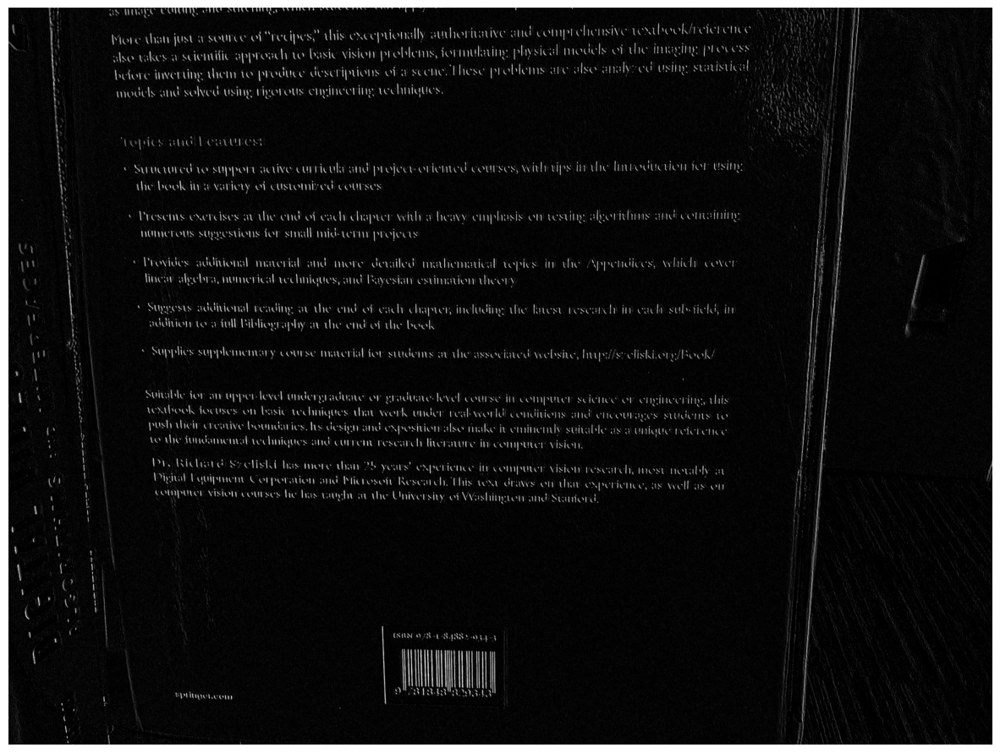

In [ ]:
blur_array = []

for img_edges in sobel_array:
    # apply a Gaussian blur to the image
    blurImage = cv2.GaussianBlur(cv2.convertScaleAbs(img_edges), (5, 5),0)

    blurImage_8bit = np.uint8(blurImage)
    blur_array.append(blurImage)

    # display the gradient image
    plt.figure(figsize=(15,15))
    plt.imshow(blurImage, cmap='gray')
    plt.axis('off')
    plt.show()


## Convert to binary image
For this project, use manual thresholding use cv2.threshold.
Experiment with manual thresholding (approx 225 works well) to get a result where the bar code is clearly visible. 

Alternatively, you could try using Otsu's method for automatic thresholding

Your end result should look like this:

![Threshold Image](<threshold image.PNG>)

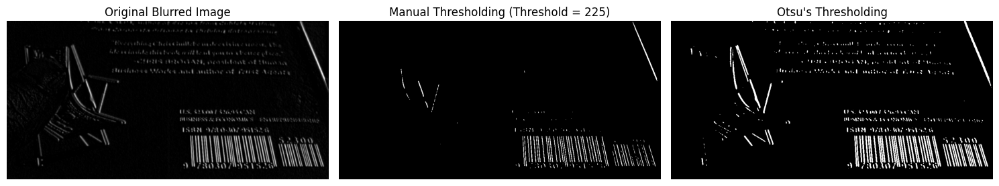

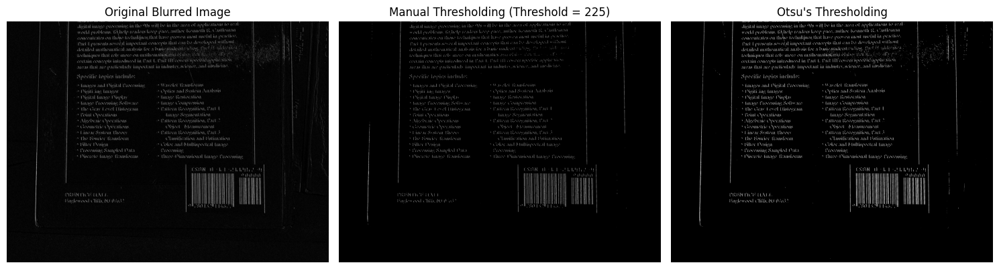

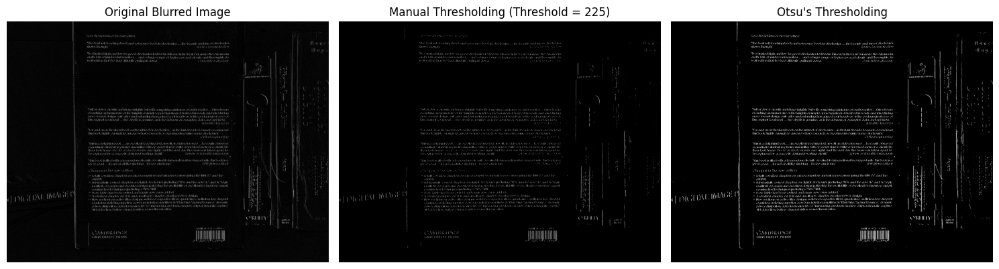

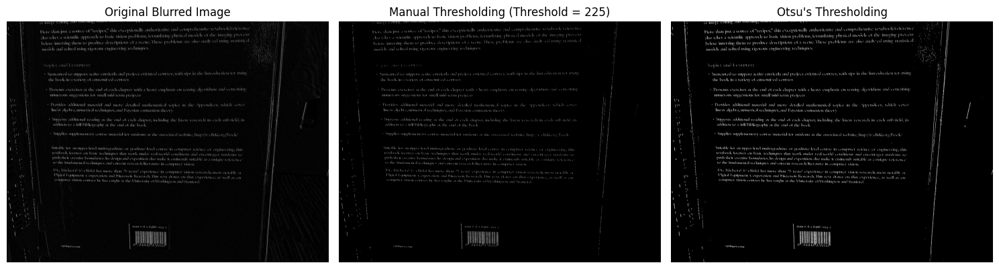

In [ ]:
thresh_manual_array = []  
thresh_otsu_array = []   

for blurImage in blur_array:
   
    ret_manual, thresh_manual = cv2.threshold(blurImage, 140, 255, cv2.THRESH_BINARY)# adjsuted the threshold of the image alot had to bring it donm to 140
    thresh_manual_array.append(thresh_manual)  
    
    
    ret_otsu, thresh_otsu = cv2.threshold(blurImage, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)
    thresh_otsu_array.append(thresh_otsu)  
    
    
    fig, axes = plt.subplots(1, 3, figsize=(15, 5)) 
    
    # Plot the original blurred image
    axes[0].imshow(blurImage, cmap='gray')
    axes[0].set_title("Original Blurred Image")
    axes[0].axis('off')
    
    # Plot the manually thresholded image
    axes[1].imshow(thresh_manual, cmap='gray')
    axes[1].set_title("Manual Thresholding")
    axes[1].axis('off')
    
    # Plot the Otsu's thresholded image
    axes[2].imshow(thresh_otsu, cmap='gray')
    axes[2].set_title("Otsu's Thresholding")
    axes[2].axis('off')
    
    
    fig.tight_layout()
    plt.show()



## Comments on the edge detection used
- Otsu's method is definitely a much better performer compared to the manual threshold method. 
- It recomended to manually threshold with 225 but I found this to be very weak so had to reduce it further. 
- I implemented the Otsu mmethod for the structuring element and dilations and erosions but I had to threshold the manual threshold to 140 in order to get it top function with the Otsu parameters I had set up below.
- It worked reasonably well at 170 but required a lower threshold in order to fully get a rectangle around the barcode. 

## Perform erosion and dilation to clean up image

The purpose of this step is slightly counterintuitive - it is to define a box shaped area where the bar code is

To do this, perform the following steps:
- Define a structuring element with the function cv2.getStructuringElement. A rectangular structuring element should work well for this application...
- Perform morphological closing using the opencv morphologyEx function
- perform an additional set of erosions using opencv erode function. Experiment with the number of iterations. 4 works well..
- perform an additional set of dilations  using opencv dilate function. Experiment with the number of iterations. 4 works well..

After these operations, you should have an image that looks something like this example below. Note that the barcode is now a solid rectangle. This is the shape we wnat to find in the next step...

![Morphed Image](<morphed image.PNG>)

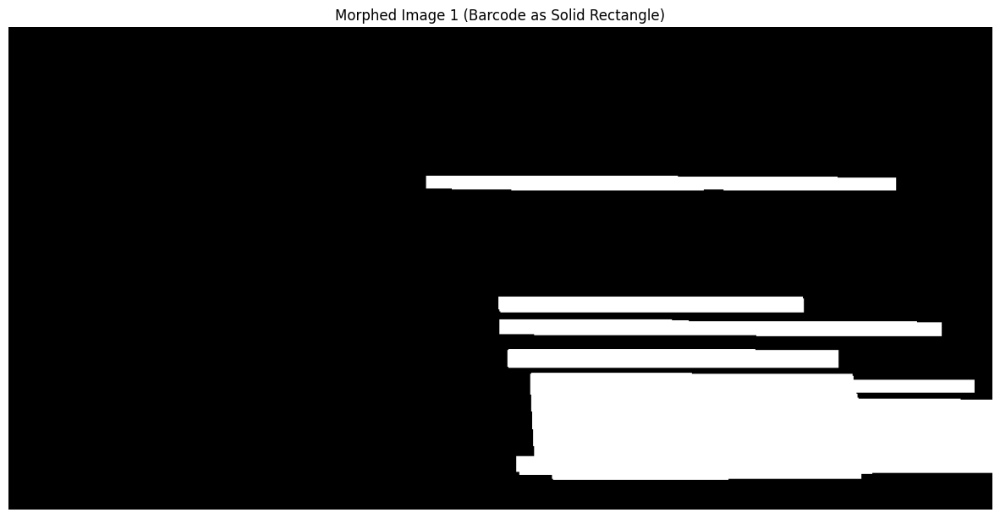

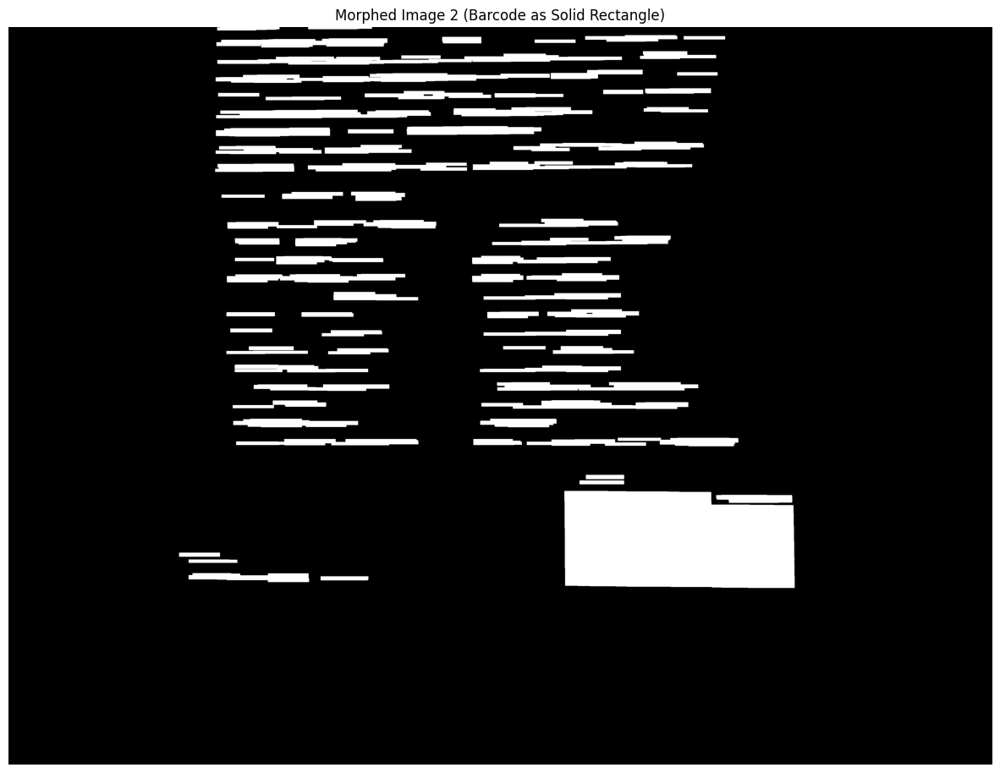

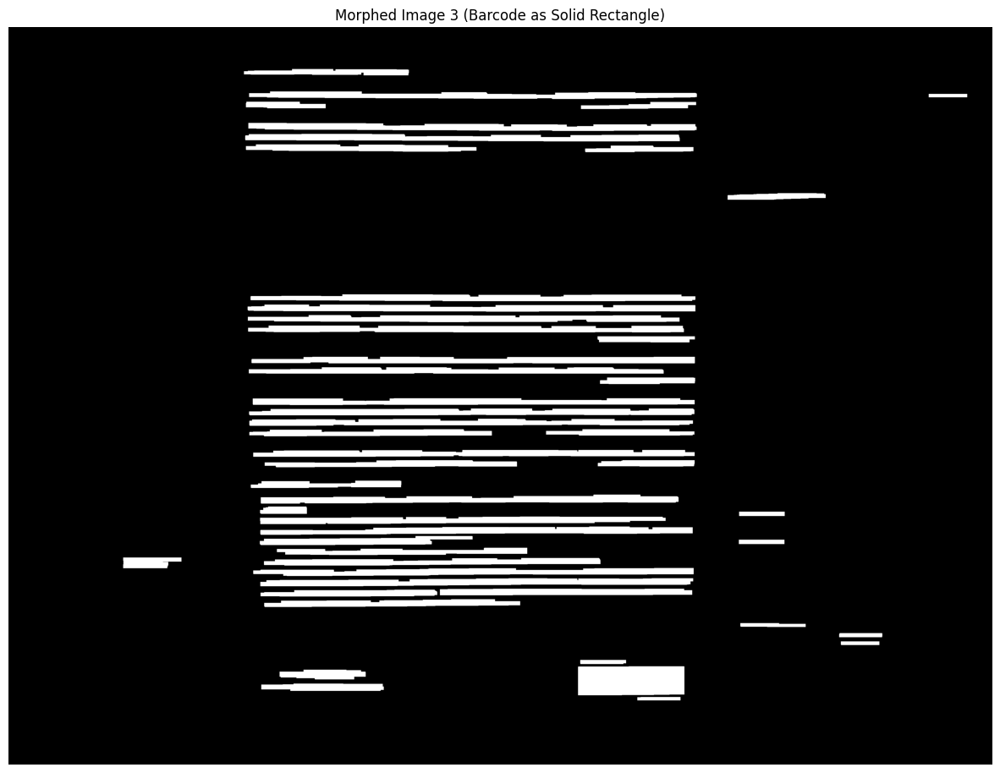

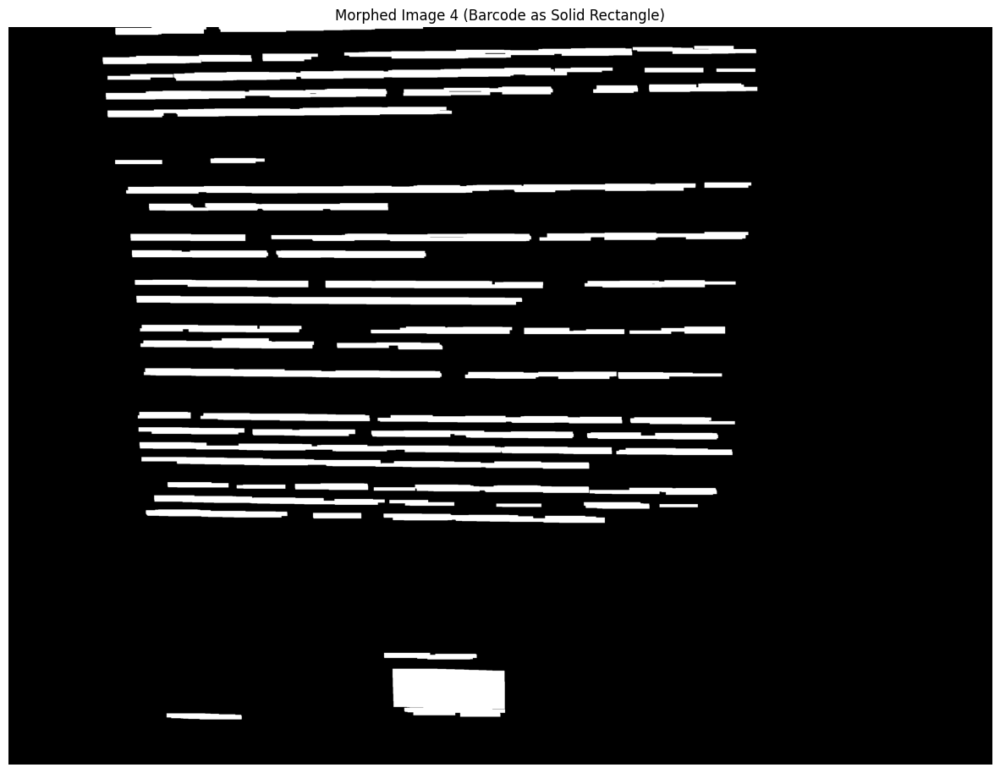

In [ ]:
Morph_array = []
for idx, (thresh_manual) in enumerate(thresh_otsu_array):
    #Define a rectangular structuring element
    kernel = cv2.getStructuringElement(cv2.MORPH_RECT, (27, 3))

    # morphological closing to close small gaps
    closed = cv2.morphologyEx(thresh_manual, cv2.MORPH_CLOSE, kernel)

    #erosions
    eroded = cv2.erode(closed, kernel, iterations=3)

    #dilations
    dilated = cv2.dilate(eroded, kernel, iterations=6)
    
    Morph_array.append(dilated)

    # Display the results
    plt.figure(figsize=(15, 15))
    plt.axis('off')
    plt.imshow(dilated, cmap='gray')
    plt.title(f"Morphed Image {idx + 1} (Barcode as Solid Rectangle)")
    plt.show()

## Comments on erosion and dilation and boxing the image
- __Initial Approach:__ I initially tried to only get the barcode contour to show up on the screen so had the lines thresholded to be quite weak before it started the dilation and erosion process.
- __Adjusting the threshold better detection:__ However when I tried to place a rectangle around the barcode it became difficult to fit it around the box fully so decided to reduce the threshold and have alot more contours on the image coming in for dilation and erosion proces in the pipeline.. 
- __Balancing Dilation and Erosion:__ The aim of the process was then to try make the contour the same size as the barcode in the original image but prevent making the contours of the blurb join together this involved a bit of playing around but once I knew it was going to involve more dilations then erosions it only took a matter of time and some trial and error seeing what contours were the biggest to get the balance correct. 
- __Handling adjacent barcodes__ The one problem was trying to get the two barcodes that are beside each other to get a box fully around both barcodes and not just the one larger barcode. I initally thought I would need to add an extra dilation process in order to get the two contours to touch and then the box would be fully drawn around the two barcodes. 
- __Changing the structuring element:__ This was not the case it involved changing the structuring element of the erosions and dilations so the smaller barcode beside the main barcode appeared a bit higher and make the two contours touch and then the the algorithm would succesfully be able to identify and box each barcode in the dataset fully.
- I turned the structuring element from a square shape to a very ractangular shape 27x3. This causees the structuring element to bring out the horizontal edges of the contours which is what was required as the algorithm was identifying the height of the barcode well but needed help identifying the width of the extra barcode to include the barcode to the side that was at a slightly smaller height. 

## Find the barcode

Use the opencv findContours function to find counters in your processed image. Contours can be explained simply as a curve joining all the continuous points (along the boundary), having same color or intensity. The contours are a useful tool for shape analysis and object detection and recognition.

Once you have found all of the contours in the image, use the sorted function to arrange the counters by size(hint: set key = cv2.contourArea)\

Define a box around the largest contour using the opencv minAreaRect function\

Use the opencv drawContours function to draw the box around the largest contour (i.e. the barcode area)

Finally, display the output image. Your result should look something like the example below:

![Barcode Found Image](<barcode found.JPG>)



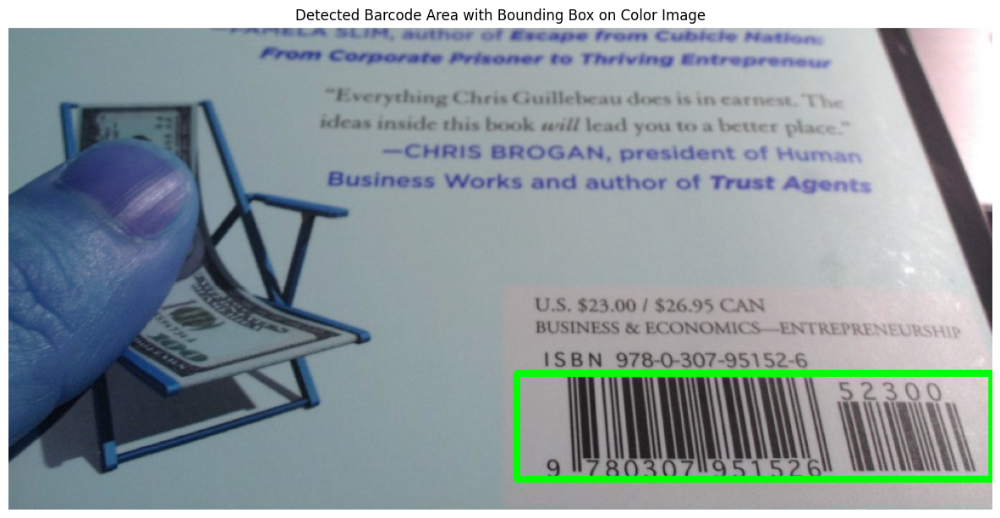

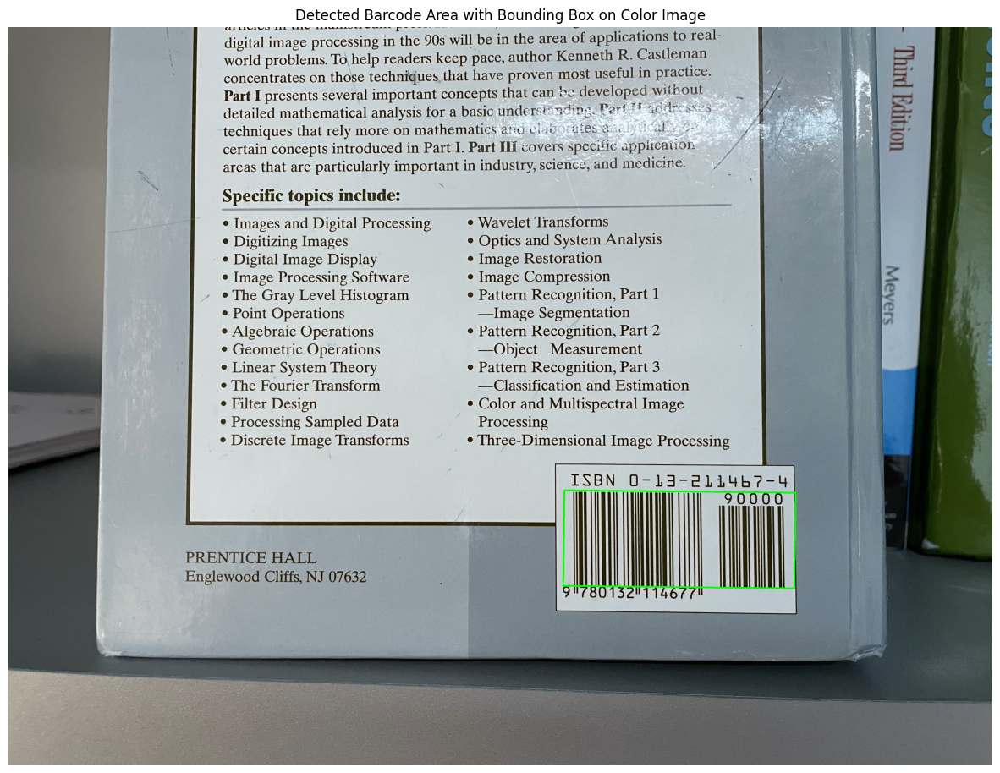

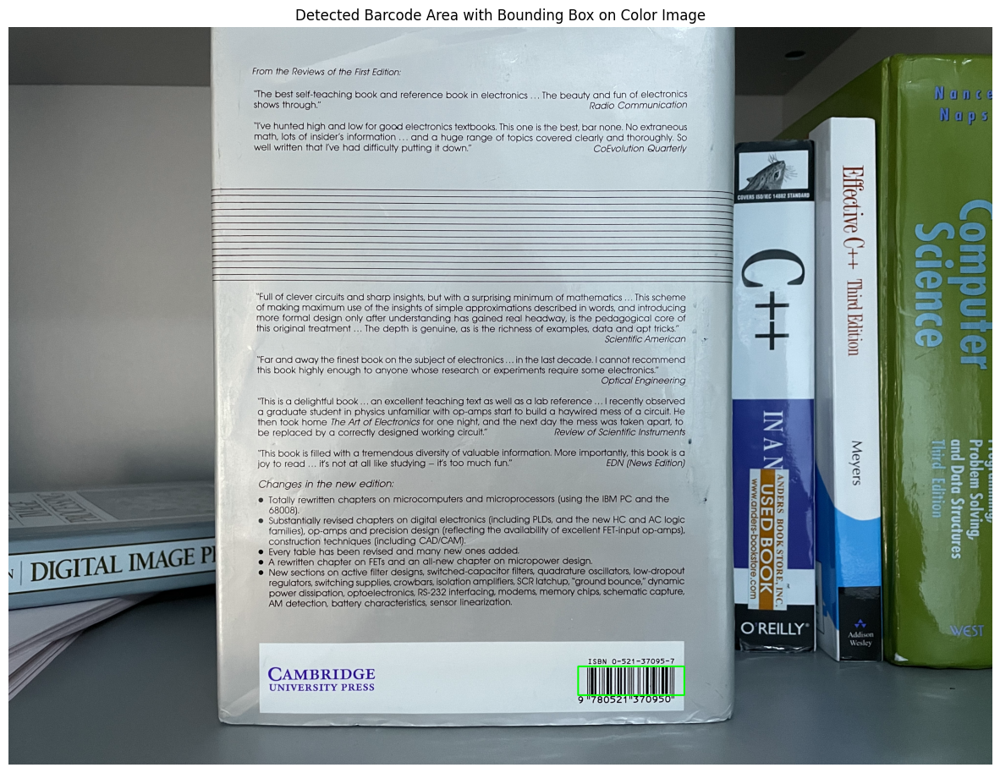

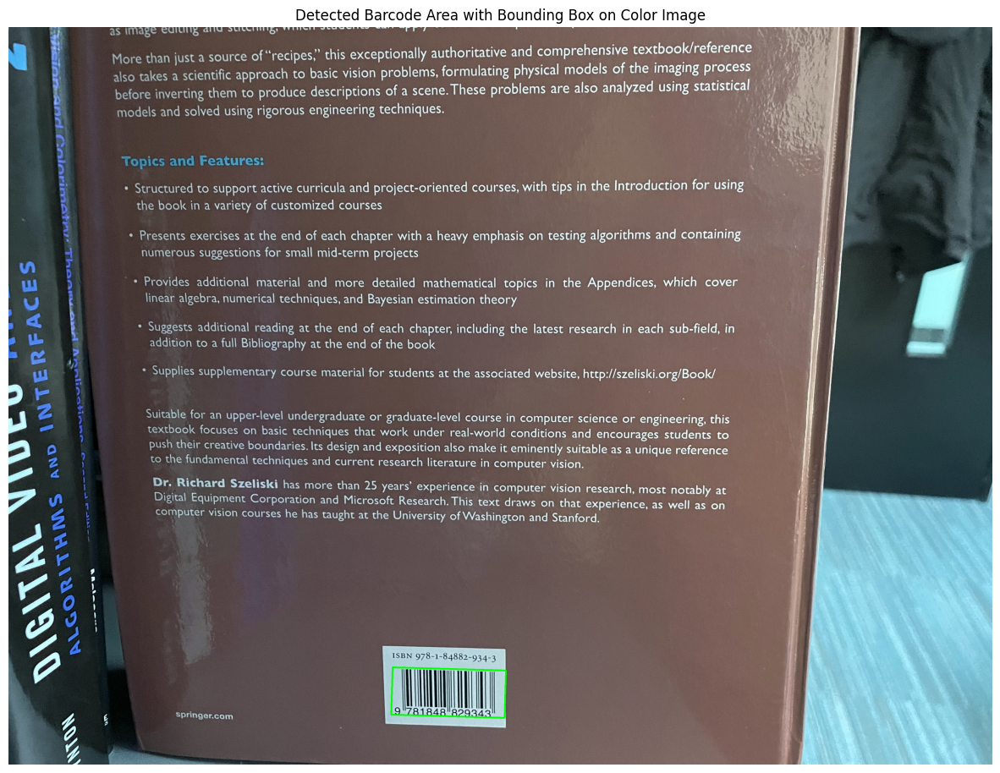

In [ ]:
colour_detect_array = []

for original_img, morphImage in zip(img_array, Morph_array):
    
    #Find contours in the morphed image
    contours, _ = cv2.findContours(morphImage, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)

    #Sort contours by area 
    contours = sorted(contours, key=cv2.contourArea, reverse=True)
    largest_contour = contours[0]

    #Get the minimum area rectangle for the lagest contour
    rect = cv2.minAreaRect(largest_contour)
    box = cv2.boxPoints(rect)
    box = np.int32(box)  # Convert coordinates to integers

    #Draw te bounding box on the original color image
    output_image = original_img.copy()  
    cv2.drawContours(output_image, [box], 0, (0, 255, 0), 5)  
    
    colour_detect_array.append(output_image)

    plt.figure(figsize=(15,15))
    plt.axis('off')
    plt.imshow(cv2.cvtColor(output_image, cv2.COLOR_BGR2RGB))  
    plt.title("Detected Barcode Area with Bounding Box on Color Image")

    plt.show()

## comment on the assignment and boxing around the coloured image
- I commented on the boxing of the image alot with the erosiona nd dilation above but once the balance was right in the morphological operations it was simple to just find the largest contour in the image and then draw a box around it aslong as the dilations sized the contour at the correct size. 

## Suggested improvements

This process works reasonably well for many images, but will not always find the correct answer. Suggest ways to improve the performance of this algorithm. Note: stating "use deep learning", or any variation of this statement, is not allowed!!!

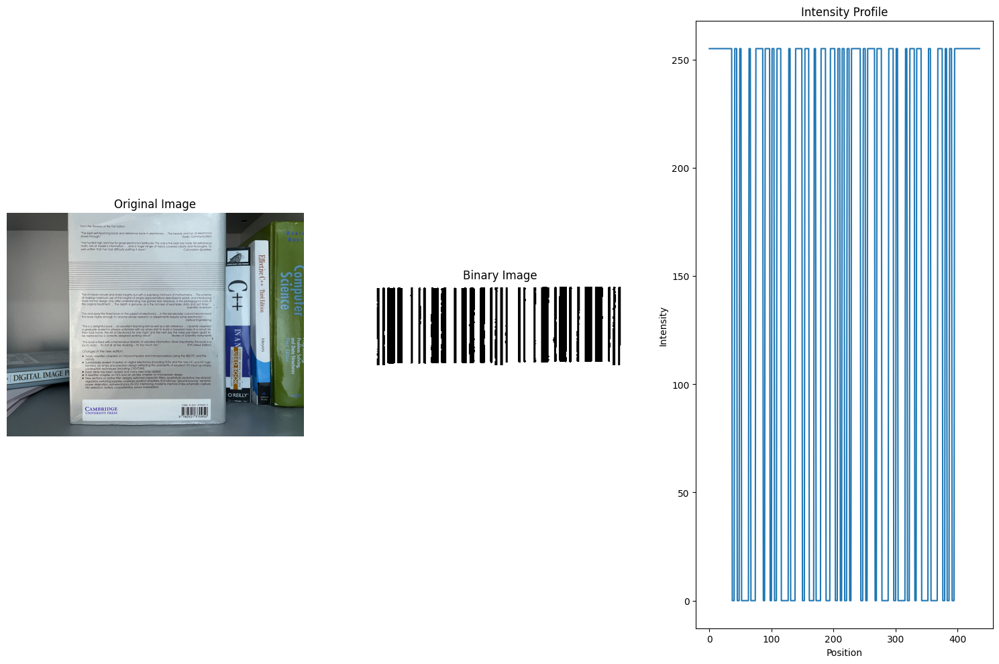

Black-White Transitions: 60


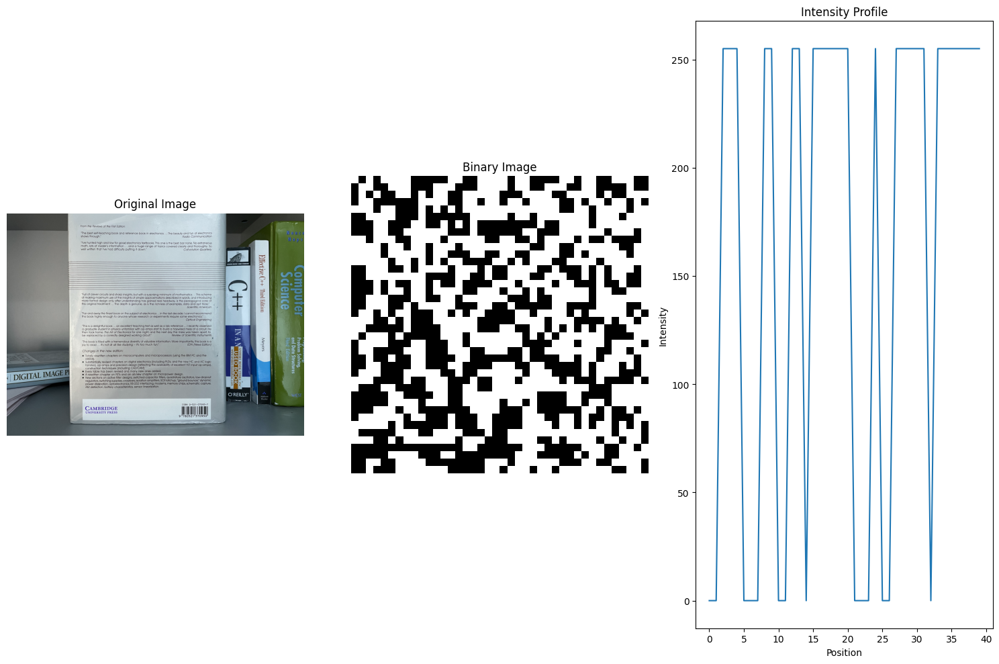

Black-White Transitions: 13


In [82]:
gray = gray_array[2]
morphImage = Morph_array[2]
original_img = img_array[2]

# Find contours
contours, _ = cv2.findContours(morphImage, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
contours = sorted(contours, key=cv2.contourArea, reverse=True)

largest_contour = contours[0]
x, y, w, h = cv2.boundingRect(largest_contour)

# Crop the ROI
cropped_roi = gray[y:y + h, x:x + w]

# Normalize and threshold the image
normalized = cv2.normalize(cropped_roi, None, 0, 255, cv2.NORM_MINMAX)
_, binary = cv2.threshold(normalized, 127, 255, cv2.THRESH_BINARY)

#  Count black-white transitions in horizontal direction
transitions = []
mid_height = h // 2 #carries out operation fromthe mid height in order to ensure that it is counting on the barcode
row = binary[mid_height, :]
transition_count = np.sum(np.abs(np.diff(row > 127)))#Each value greater the n 127 is white and less then 127 is black
#plot the results   
fig, axs = plt.subplots(1, 3, figsize=(15, 10))

# Original image
axs[0].imshow(cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB))
axs[0].set_title("Original Image")
axs[0].axis("off")

# Binary image
axs[1].imshow(binary, cmap='gray')
axs[1].set_title("Binary Image")
axs[1].axis("off")

# Plot transitions
axs[2].plot(row)
axs[2].set_title("Intensity Profile")
axs[2].set_xlabel("Position")
axs[2].set_ylabel("Intensity")

plt.tight_layout()
plt.show()

print(f"Black-White Transitions: {transition_count}")


largest_contour = contours[1]
x, y, w, h = cv2.boundingRect(largest_contour)
# crop the roi which is the biggest contour
cropped_roi = gray[100:140, 250:290]

# Normalize and threshold the image
normalized = cv2.normalize(cropped_roi, None, 0, 255, cv2.NORM_MINMAX)
_, binary = cv2.threshold(normalized, 127, 255, cv2.THRESH_BINARY)

#  Count black-white transitions in horizontal direction
transitions = []
mid_height = h // 2 #carries out operation fromthe mid height in order to ensure that it is counting on the barcode
row = binary[mid_height, :] 
transition_count = np.sum(np.abs(np.diff(row > 127))) #Each value greater the n 127 is white and less then 127 is black
    
#plot the results
fig, axs = plt.subplots(1, 3, figsize=(15, 10))

# Original image
axs[0].imshow(cv2.cvtColor(original_img, cv2.COLOR_BGR2RGB))
axs[0].set_title("Original Image")
axs[0].axis("off")

# Binary image
axs[1].imshow(binary, cmap='gray')
axs[1].set_title("Binary Image")
axs[1].axis("off")

# Plot transitions
axs[2].plot(row)
axs[2].set_title("Intensity Profile")
axs[2].set_xlabel("Position")
axs[2].set_ylabel("Intensity")

plt.tight_layout()
plt.show()

print(f"Black-White Transitions: {transition_count}")

## Comments on improvements
- The mainway to differentiate between a barcode and anything else is the transition from black to white so a good way to ensure that it is a barcode is to measure this transition.
- It firstly gets the crop and thresholds it to be black or white and then it carries out an operation from the mid height of the crop counting the changes from black to white.
- It is plotted above where it takes the largest contour(barcode) and second largest contour and you can see there is a clear difference in the transitions from black to white. 
- You simply threshold it with the amount of lines a barcode usually is to guarantee it is a barcode that is being recognised.You can see the barcode has 60 transitions and the other contour has 13 
- This was the best implementation I could think of as the words that could be a bigger contour then the barcode would have nowhere near the amount of transitions from black to white as the bar code itself so it is a good safety for this implemetation.